# Generative modelling for  optical plasma diagnostics

## Authors - Gregory A Daly $^{1*}$, Jonathan E Fieldsend $^1$, Gavin A Tabor $^1$

$^1$ College of Engineering, Mathematics and Physical Sciences, Harrison Building, Streatham Campus, University of Exeter, North Park Road, Exeter, UK, EX4 4QF

*daly.gregory@gmail.com

This notebook provides a demonstration of how to plot latent spaces.

The model requires tensorflow to be installed on your system, please refer to the [Tensorflow install instructions](https://www.tensorflow.org/install/pip) for detailed instructions for your OS and GPU.

We use plotly for all figures, it can be [installed with pip or conda](https://plotly.com/python/getting-started/)

In [103]:
import tensorflow as tf
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.io as pio
import numpy as np
import tarfile
import pandas as pd

#I like dark themes, comment out for the default or set to plotly_white for the light theme
pio.templates.default = "plotly_dark" 

In [104]:
train_tool = pd.read_csv('train_tool_log_ar_o2_flour_2nd_split.csv')
test_tool = pd.read_csv('test_tool_log_ar_o2_flour_2nd_split.csv')
validation_tool = pd.read_csv('val_tool_log_ar_o2_flour_2nd_split.csv')

Trained model files are included in the repository, but are compressed into tarballs, first we must extract them.

On google colab, we will also have to download the files first.

In [125]:
latent_units = 4

train_latents = np.load('latents/train_latents_l' + str(latent_units) + '.npy')
test_latents = np.load('latents/test_latents_l' + str(latent_units) + '.npy')
validation_latents = np.load('latents/val_latents_l' + str(latent_units) + '.npy')

i = 1

j = 2

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')


fig.update_layout({
#                     'plot_bgcolor': 'rgba(0, 0, 0, 0)',
#                     'paper_bgcolor': 'rgba(0, 0, 0, 0)',
                    }, xaxis_title = '2nd Latent dimension', yaxis_title = '4th Latent dimension',
                    )
fig.update_layout(font = dict(family='"Open Sans", verdana, arial, sans-serif', 
                              color='black',
                              size=18))
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_traces(marker = dict(size=2, colorscale='Viridis'), selector=dict(mode='markers'))
# fig.update_traces(marker_size=2)
fig.show('notebook')

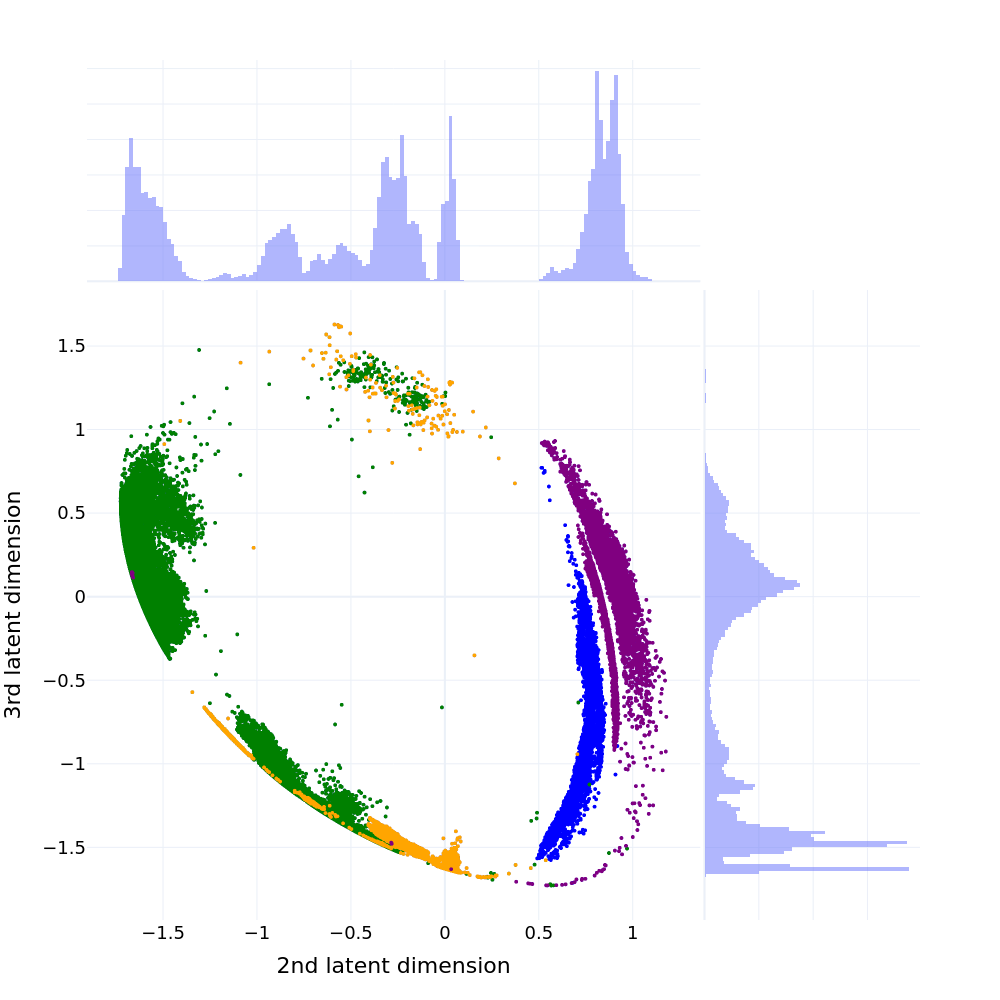

In [128]:
fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')

# fig.update_xaxes(title_text=f'2nd latent dimension')
# fig.update_yaxes(title_text=f'3rd latent dimension')

fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '2nd latent dimension'
fig['layout']['yaxis']['title'] = '3rd latent dimension'


fig.show('png')

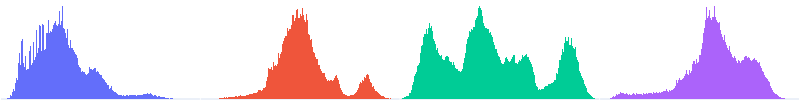

In [65]:
rows = 1

fig = make_subplots(rows=rows, cols=4, vertical_spacing=0.001,  horizontal_spacing=0.001)

for i in range(4):
    
        fig.add_trace(go.Histogram(x=train_latents[:,(i)]), row = 1, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train.eps')

In [129]:
latent_units = 8

train_latents = np.load('latents/train_latents_l' + str(latent_units) + '.npy')
test_latents = np.load('latents/test_latents_l' + str(latent_units) + '.npy')
validation_latents = np.load('latents/val_latents_l' + str(latent_units) + '.npy')

i = 3

j = 6

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')
fig.update_layout({
#                     'plot_bgcolor': 'rgba(0, 0, 0, 0)',
#                     'paper_bgcolor': 'rgba(0, 0, 0, 0)',
                    }, xaxis_title = '2nd Latent dimension', yaxis_title = '4th Latent dimension',
                    )
fig.update_layout(font = dict(family='"Open Sans", verdana, arial, sans-serif', 
                              color='black',
                              size=18))
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_traces(marker = dict(size=2, colorscale='Viridis'), selector=dict(mode='markers'))
# fig.update_traces(marker_size=2)
fig.show('notebook')

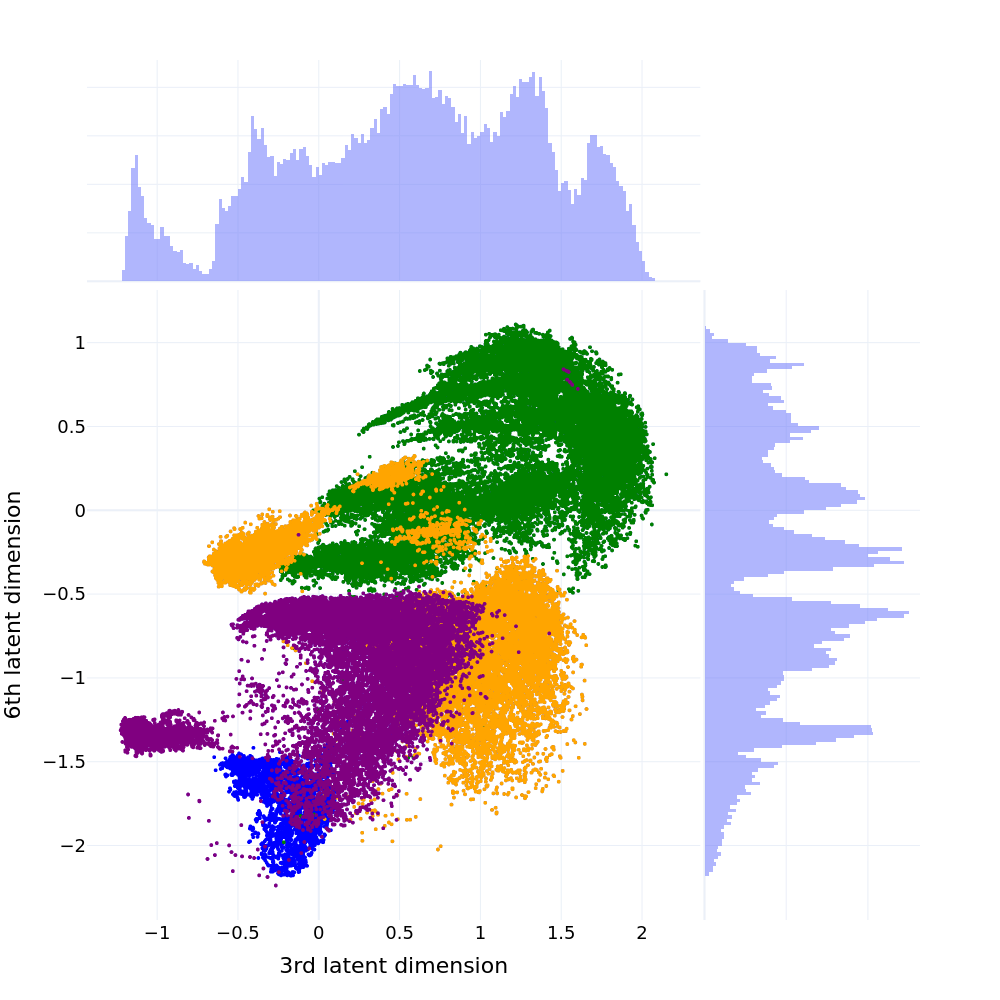

In [130]:
fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')



fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '3rd latent dimension'
fig['layout']['yaxis']['title'] = '6th latent dimension'

fig.show('png')

0 0 0
1 1 0
2 2 0
3 3 0
4 4 0
5 5 0
6 6 0
7 7 0


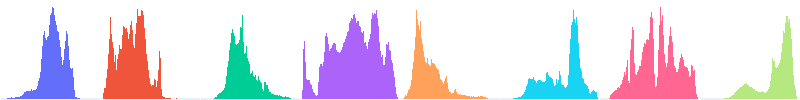

In [68]:
rows = int(latent_units/8)

fig = make_subplots(rows=rows, cols=8, vertical_spacing=0.001,  horizontal_spacing=0.001)

for j in range(rows):
    for i in range(8):
#     fig = px.histogram(x = test_latents[:,i], width = 200, height = 200)
        print((j)*8 + i, i, j)
    
        fig.add_trace(go.Histogram(x=train_latents[:,((j)*8 + i)]), row = 1+j, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train.eps')

In [161]:
latent_units = 16

train_latents = np.load('latents/train_latents_l' + str(latent_units) + '.npy')
test_latents = np.load('latents/test_latents_l' + str(latent_units) + '.npy')
validation_latents = np.load('latents/val_latents_l' + str(latent_units) + '.npy')

# i = 2

# j = 15

i = 7

j = 14

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')
fig.update_layout({
#                     'plot_bgcolor': 'rgba(0, 0, 0, 0)',
#                     'paper_bgcolor': 'rgba(0, 0, 0, 0)',
                    }, xaxis_title = '2nd Latent dimension', yaxis_title = '4th Latent dimension',
                    )
fig.update_layout(font = dict(family='"Open Sans", verdana, arial, sans-serif', 
                              color='black',
                              size=18))
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_traces(marker = dict(size=2, colorscale='Viridis'), selector=dict(mode='markers'))
# fig.update_traces(marker_size=2)
fig.show('notebook')

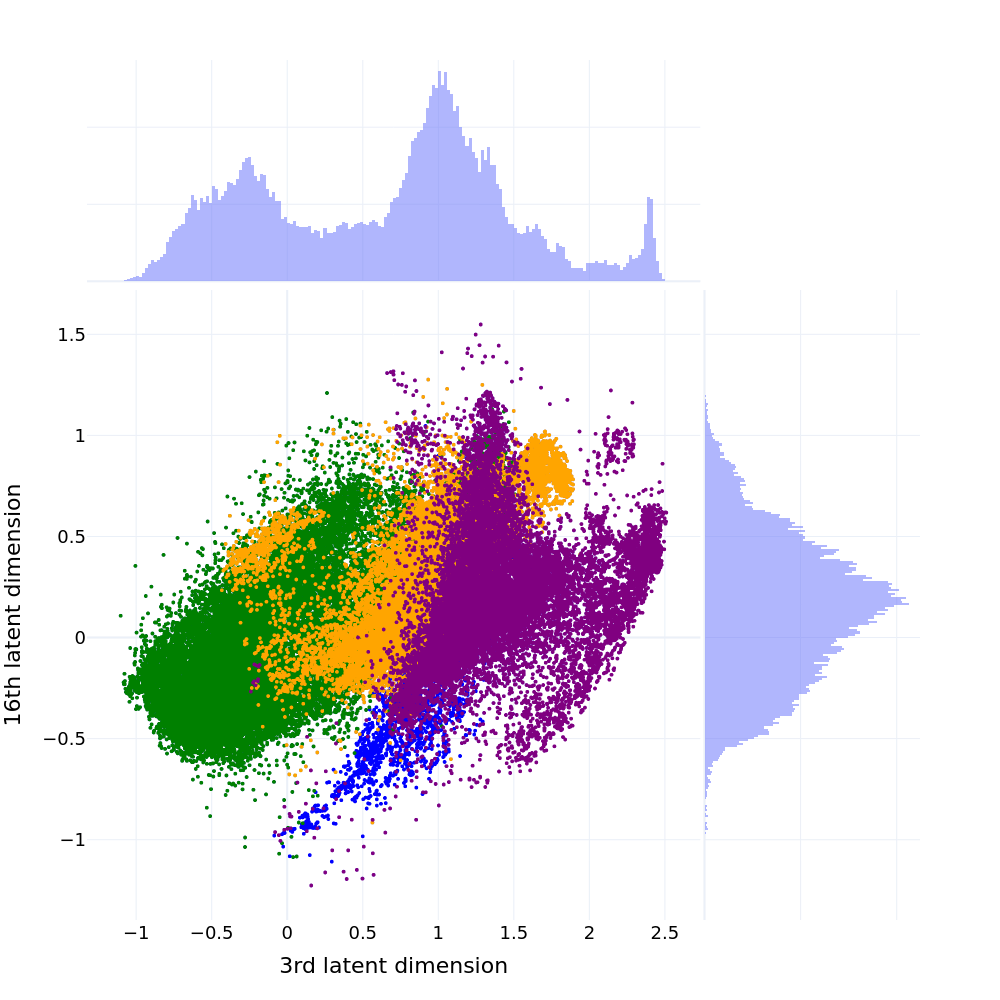

In [162]:
fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')

fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '3rd latent dimension'
fig['layout']['yaxis']['title'] = '16th latent dimension'

fig.show('png')

In [71]:
train_latents.shape

(650005, 16)

2
0 0 0
1 1 0
2 2 0
3 3 0
4 4 0
5 5 0
6 6 0
7 7 0
8 0 1
9 1 1
10 2 1
11 3 1
12 4 1
13 5 1
14 6 1
15 7 1


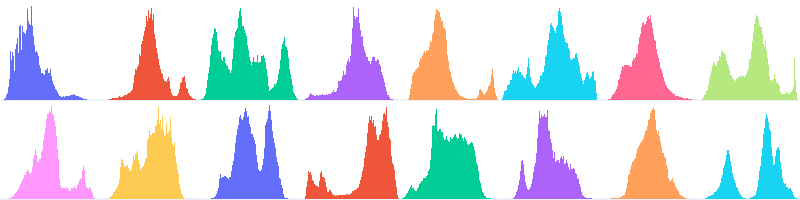

In [72]:
rows = int(latent_units/8)

print(rows)

fig = make_subplots(rows=rows, cols=8, vertical_spacing=0.001,  horizontal_spacing=0.001)

for j in range(rows):
    for i in range(8):
#     fig = px.histogram(x = test_latents[:,i], width = 200, height = 200)
        print((j)*8 + i, i, j)
    
        fig.add_trace(go.Histogram(x=train_latents[:,((j)*8 + i)]), row = 1+j, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train.eps')

In [133]:
latent_units = 32

train_latents = np.load('latents/train_latents_l' + str(latent_units) + '.npy')
test_latents = np.load('latents/test_latents_l' + str(latent_units) + '.npy')
validation_latents = np.load('latents/val_latents_l' + str(latent_units) + '.npy')

i = 6

j = 30

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')
fig.update_layout({
#                     'plot_bgcolor': 'rgba(0, 0, 0, 0)',
#                     'paper_bgcolor': 'rgba(0, 0, 0, 0)',
                    }, xaxis_title = '2nd Latent dimension', yaxis_title = '4th Latent dimension',
                    )
fig.update_layout(font = dict(family='"Open Sans", verdana, arial, sans-serif', 
                              color='black',
                              size=18))
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_traces(marker = dict(size=2, colorscale='Viridis'), selector=dict(mode='markers'))
# fig.update_traces(marker_size=2)
fig.show('notebook')

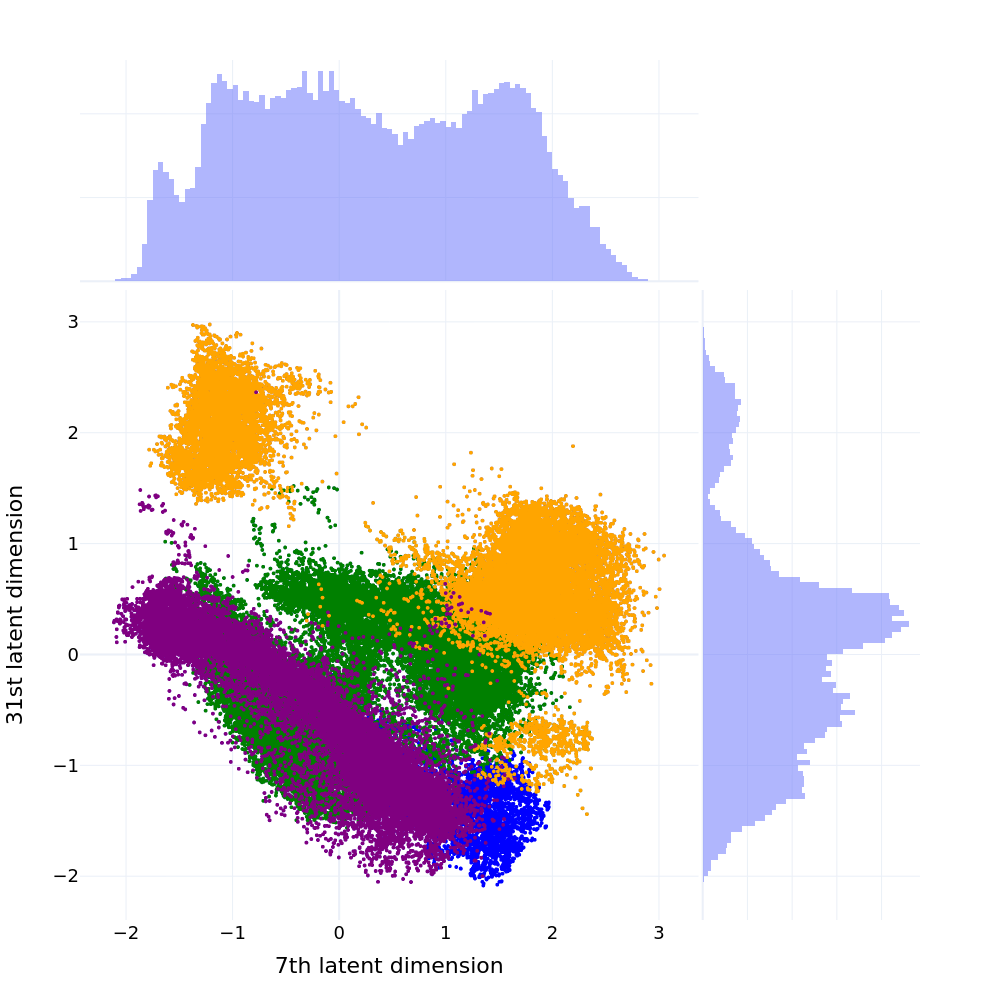

In [134]:
fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')

fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '7th latent dimension'
fig['layout']['yaxis']['title'] = '31st latent dimension'

fig.show('png')

0 0 0
1 1 0
2 2 0
3 3 0
4 4 0
5 5 0
6 6 0
7 7 0
8 0 1
9 1 1
10 2 1
11 3 1
12 4 1
13 5 1
14 6 1
15 7 1
16 0 2
17 1 2
18 2 2
19 3 2
20 4 2
21 5 2
22 6 2
23 7 2
24 0 3
25 1 3
26 2 3
27 3 3
28 4 3
29 5 3
30 6 3
31 7 3


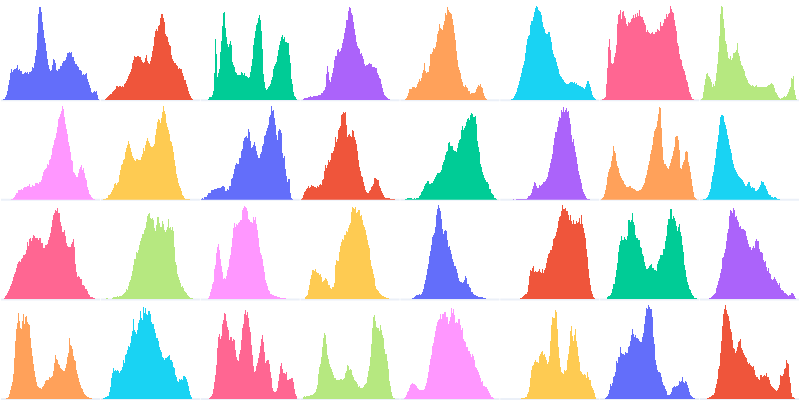

In [85]:
rows = int(latent_units/8)

fig = make_subplots(rows=rows, cols=8, vertical_spacing=0.001,  horizontal_spacing=0.001)

for j in range(rows):
    for i in range(8):
#     fig = px.histogram(x = test_latents[:,i], width = 200, height = 200)
        print((j)*8 + i, i, j)
    
        fig.add_trace(go.Histogram(x=train_latents[:,((j)*8 + i)]), row = 1+j, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train.eps')

In [157]:
latent_units = 64

train_latents = np.load('latents/train_latents_l' + str(latent_units) + '.npy')
test_latents = np.load('latents/test_latents_l' + str(latent_units) + '.npy')
validation_latents = np.load('latents/val_latents_l' + str(latent_units) + '.npy')

i = 4

j = 59

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')
fig.update_layout({
#                     'plot_bgcolor': 'rgba(0, 0, 0, 0)',
#                     'paper_bgcolor': 'rgba(0, 0, 0, 0)',
                    }, xaxis_title = '2nd Latent dimension', yaxis_title = '4th Latent dimension',
                    )
fig.update_layout(font = dict(family='"Open Sans", verdana, arial, sans-serif', 
                              color='black',
                              size=18))
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='black', zeroline=True, zerolinewidth=1, zerolinecolor='black')
fig.update_traces(marker = dict(size=2, colorscale='Viridis'), selector=dict(mode='markers'))
# fig.update_traces(marker_size=2)
fig.show('notebook')

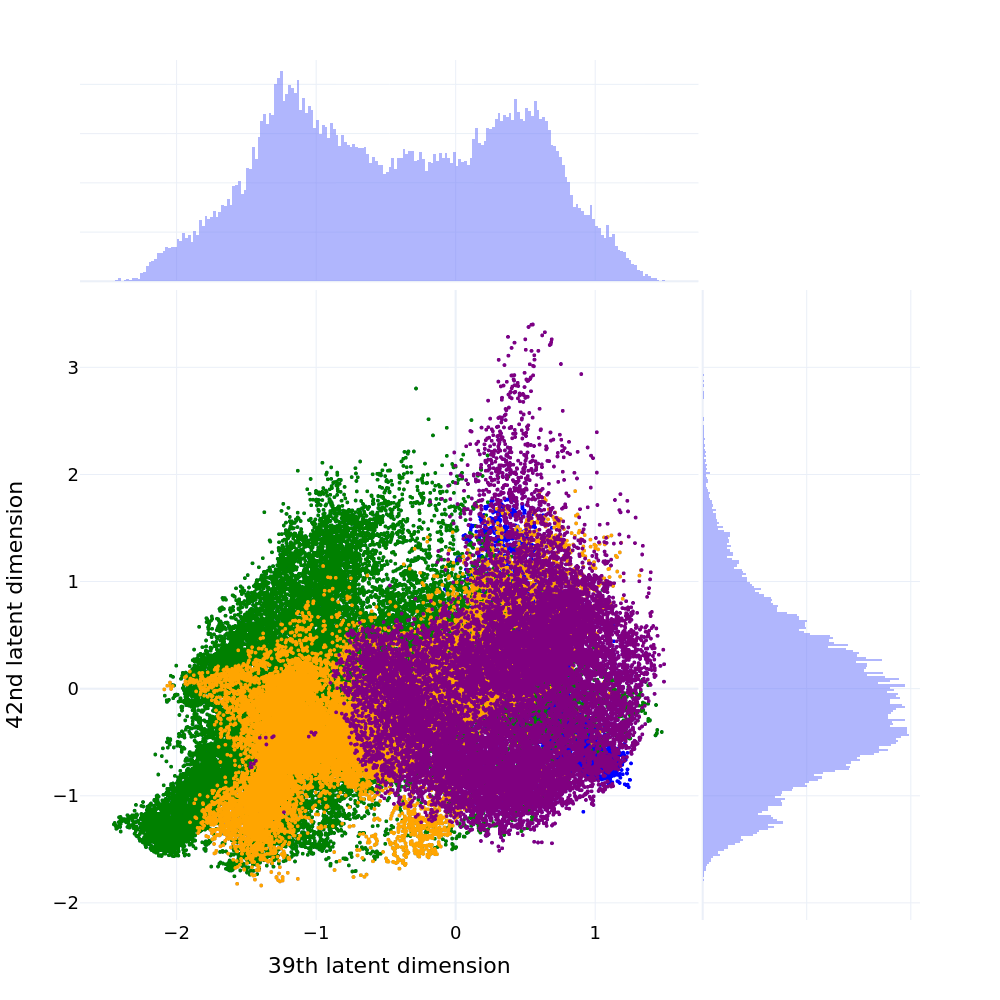

In [158]:
fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')

fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '39th latent dimension'
fig['layout']['yaxis']['title'] = '42nd latent dimension'

fig.show('png')

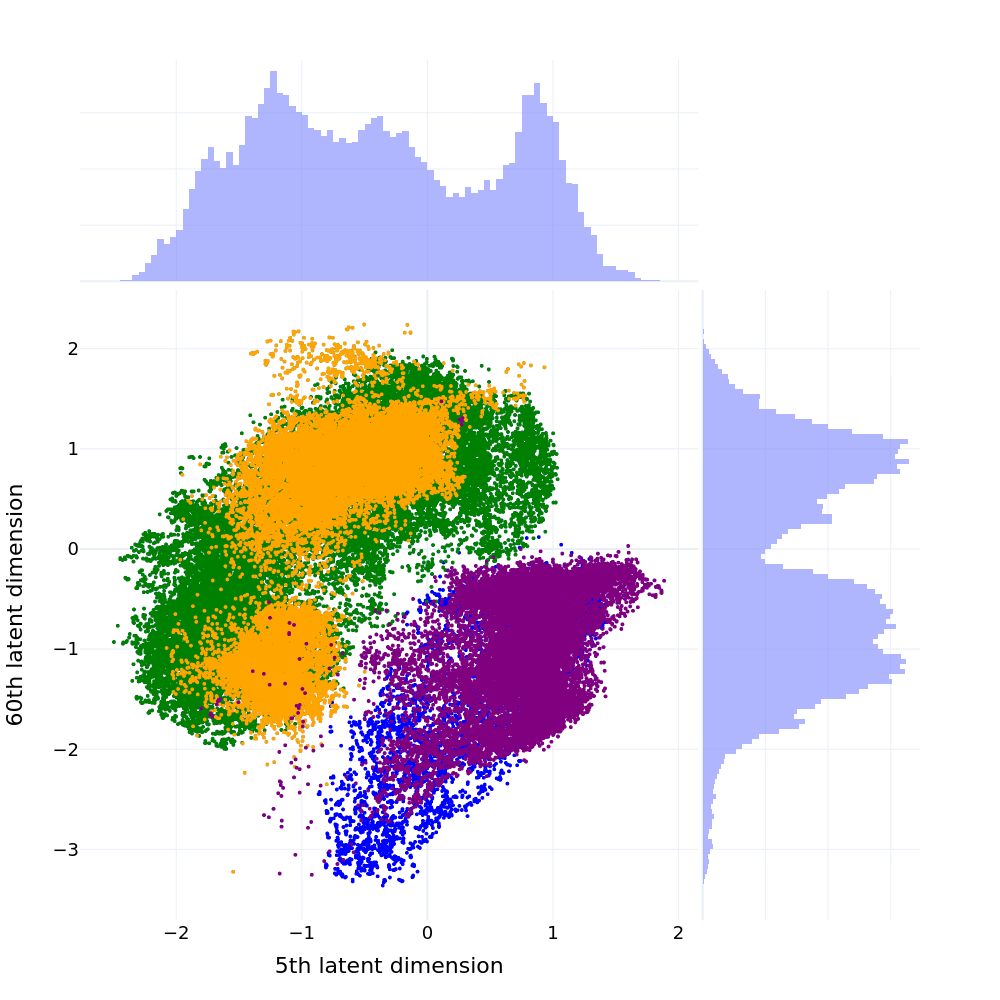

In [160]:
i = 9

j = 53

fig = px.scatter(x=test_latents[:,i], y=test_latents[:,j], marginal_x="histogram", marginal_y="histogram", width = 1000, height = 1000, template = 'plotly_white', render_mode = 'webgl')

fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['O2_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'O2', marker=dict(size=4, color='blue')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['SF6_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'SF6', marker=dict(size=4, color='green')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['CF4_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'CF4', marker=dict(size=4, color='orange')))
fig.add_trace(go.Scattergl(x = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), i], y = test_latents[test_tool[test_tool['Ar_FLOW'] > 0.01].index.values.tolist(), j], mode = 'markers', name = 'Argon', marker=dict(size=4, color='purple')))

fig.update_layout(
    showlegend = False,
    autosize=False,
    width=1000,
    height=1000,
    legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
    ), 
    template = 'plotly_white',
    font = dict(family='"Outfit Light", verdana, arial, sans-serif', 
                              color='black',
                              size=18),
    plot_bgcolor = 'rgba(0, 0, 0, 0)',
    paper_bgcolor = 'rgba(0, 0, 0, 0)',
)

fig.update_traces(marker = dict(size=4), selector=dict(mode='markers'))

fig['layout']['xaxis']['title'] = '5th latent dimension'
fig['layout']['yaxis']['title'] = '60th latent dimension'

fig.show('png')

0 0 0
1 1 0
2 2 0
3 3 0
4 4 0
5 5 0
6 6 0
7 7 0
8 0 1
9 1 1
10 2 1
11 3 1
12 4 1
13 5 1
14 6 1
15 7 1
16 0 2
17 1 2
18 2 2
19 3 2
20 4 2
21 5 2
22 6 2
23 7 2
24 0 3
25 1 3
26 2 3
27 3 3
28 4 3
29 5 3
30 6 3
31 7 3


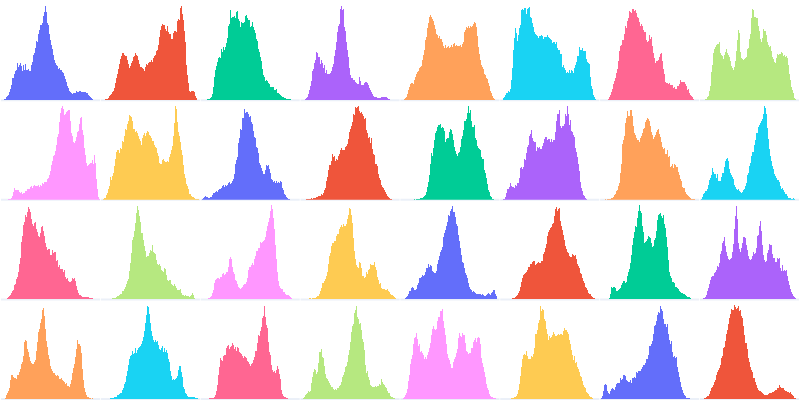

In [95]:
rows = int(latent_units/16)

fig = make_subplots(rows=rows, cols=8, vertical_spacing=0.001,  horizontal_spacing=0.001)

for j in range(rows):
    for i in range(8):
#     fig = px.histogram(x = test_latents[:,i], width = 200, height = 200)
        print((j)*8 + i, i, j)
    
        fig.add_trace(go.Histogram(x=train_latents[:,((j)*8 + i)]), row = 1+j, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train.eps')

32 0 0
33 1 0
34 2 0
35 3 0
36 4 0
37 5 0
38 6 0
39 7 0
40 0 1
41 1 1
42 2 1
43 3 1
44 4 1
45 5 1
46 6 1
47 7 1
48 0 2
49 1 2
50 2 2
51 3 2
52 4 2
53 5 2
54 6 2
55 7 2
56 0 3
57 1 3
58 2 3
59 3 3
60 4 3
61 5 3
62 6 3
63 7 3


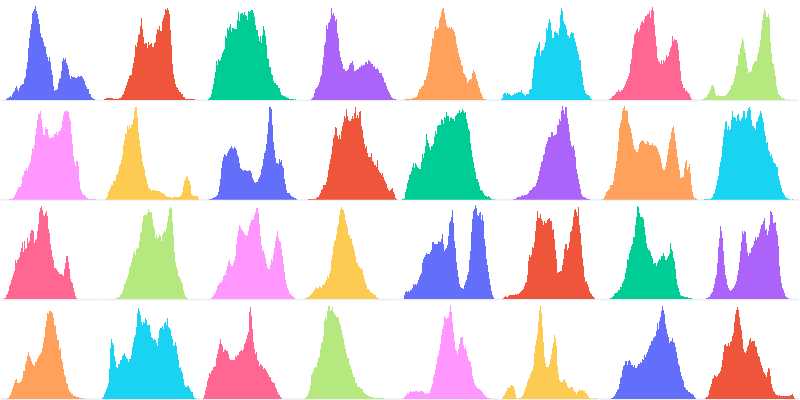

In [96]:
rows = int(latent_units/16)

fig = make_subplots(rows=rows, cols=8, vertical_spacing=0.001,  horizontal_spacing=0.001)

for j in range(rows):
    for i in range(8):
#     fig = px.histogram(x = test_latents[:,i], width = 200, height = 200)
        print((4+j)*8 + i, i, j)
    
        fig.add_trace(go.Histogram(x=train_latents[:,((4+j)*8 + i)]), row = 1+j, col = i+1)
        
fig.update_layout(showlegend=False)

fig.update_layout(
    template='plotly_white',
    autosize=False,
    width=800,
    height=100*rows,
    margin=dict(
        l=1,
        r=1,
        b=1,
        t=1,
        pad=1
    )
    )
    
fig.update_xaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(showticklabels=False, showgrid=False)
fig.update_yaxes(automargin=True)
fig.show('png')
fig.write_image('images/latent_l' + str(latent_units) + '_hist_grid_train_part_2.eps')